In [ ]:
import os

os.environ["KERAS_BACKEND"] = "tensorflow"

import numpy as np
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt

import keras
from keras import layers
from keras import ops

AUTOTUNE = tf.data.AUTOTUNE

In [ ]:

div2k_data = tfds.image.Div2k(config="bicubic_x4")
div2k_data.download_and_prepare()


train = div2k_data.as_dataset(split="train", as_supervised=True)
train_cache = train.cache()

val = div2k_data.as_dataset(split="validation", as_supervised=True)
val_cache = val.cache()

EXTRACTING {'train_lr_url': 'https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_LR_bicubic_X4.zip', 'valid_lr_url': 'https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_LR_bicubic_X4.zip', 'train_hr_url': 'https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip', 'valid_hr_url': 'https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_HR.zip'}


Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/2 [00:00<?, ? splits/s]

Generating train examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/div2k/bicubic_x4/incomplete.UYEQME_2.0.0/div2k-train.tfrecord*...:   0%|  …

Generating validation examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/div2k/bicubic_x4/incomplete.UYEQME_2.0.0/div2k-validation.tfrecord*...:   …

Dataset div2k downloaded and prepared to /root/tensorflow_datasets/div2k/bicubic_x4/2.0.0. Subsequent calls will reuse this data.


In [ ]:
def flip_left_right(lowres_img, highres_img):
    """Flips Images to left and right."""


    rn = keras.random.uniform(shape=(), maxval=1)

    return ops.cond(
        rn < 0.5,
        lambda: (lowres_img, highres_img),
        lambda: (
            ops.flip(lowres_img),
            ops.flip(highres_img),
        ),
    )


def random_rotate(lowres_img, highres_img):
    """Rotates Images by 90 degrees."""


    rn = ops.cast(
        keras.random.uniform(shape=(), maxval=4, dtype="float32"), dtype="int32"
    )

    return tf.image.rot90(lowres_img, rn), tf.image.rot90(highres_img, rn)


def random_crop(lowres_img, highres_img, hr_crop_size=96, scale=4):
    """Crop images.

    low resolution images: 24x24
    high resolution images: 96x96
    """
    lowres_crop_size = hr_crop_size // scale
    lowres_img_shape = ops.shape(lowres_img)[:2]

    lowres_width = ops.cast(
        keras.random.uniform(
            shape=(), maxval=lowres_img_shape[1] - lowres_crop_size + 1, dtype="float32"
        ),
        dtype="int32",
    )
    lowres_height = ops.cast(
        keras.random.uniform(
            shape=(), maxval=lowres_img_shape[0] - lowres_crop_size + 1, dtype="float32"
        ),
        dtype="int32",
    )

    highres_width = lowres_width * scale
    highres_height = lowres_height * scale

    lowres_img_cropped = lowres_img[
        lowres_height : lowres_height + lowres_crop_size,
        lowres_width : lowres_width + lowres_crop_size,
    ]
    highres_img_cropped = highres_img[
        highres_height : highres_height + hr_crop_size,
        highres_width : highres_width + hr_crop_size,
    ]
    return lowres_img_cropped, highres_img_cropped

In [ ]:
def dataset_object(dataset_cache, training=True):
    ds = dataset_cache
    ds = ds.map(
        lambda lowres, highres: random_crop(lowres, highres, scale=4),
        num_parallel_calls=AUTOTUNE,
    )

    if training:
        ds = ds.map(random_rotate, num_parallel_calls=AUTOTUNE)
        ds = ds.map(flip_left_right, num_parallel_calls=AUTOTUNE)

    ds = ds.batch(16)

    if training:

        ds = ds.repeat()

    ds = ds.prefetch(buffer_size=AUTOTUNE)
    return ds


train_ds = dataset_object(train_cache, training=True)
val_ds = dataset_object(val_cache, training=False)

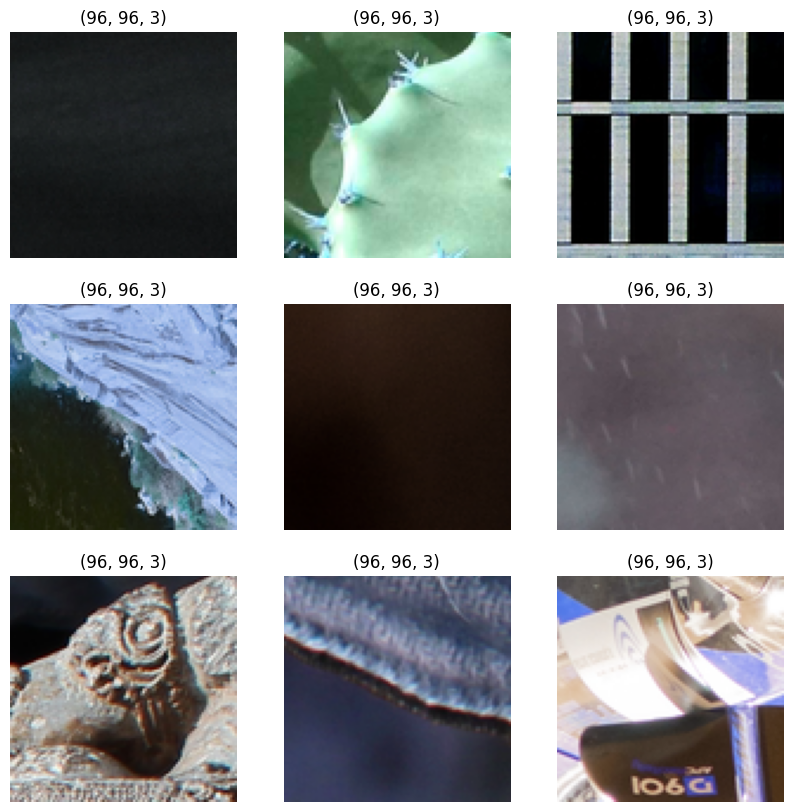

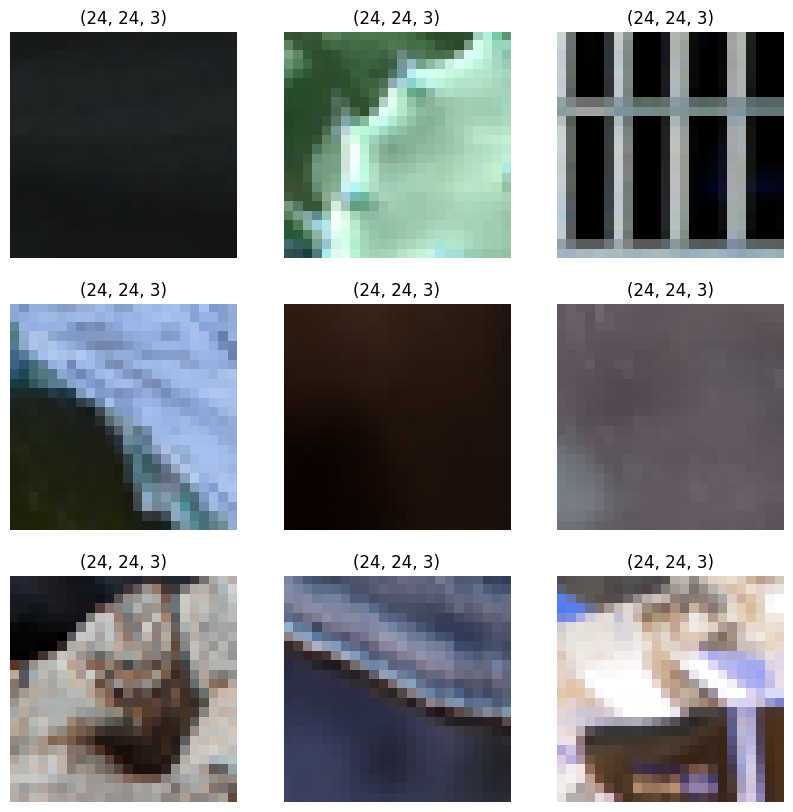

In [ ]:
lowres, highres = next(iter(train_ds))


plt.figure(figsize=(10, 10))
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(highres[i].numpy().astype("uint8"))
    plt.title(highres[i].shape)
    plt.axis("off")


plt.figure(figsize=(10, 10))
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(lowres[i].numpy().astype("uint8"))
    plt.title(lowres[i].shape)
    plt.axis("off")


def PSNR(super_resolution, high_resolution):
    """Compute the peak signal-to-noise ratio, measures quality of image."""

    psnr_value = tf.image.psnr(high_resolution, super_resolution, max_val=255)[0]
    return psnr_value

In [ ]:
class EDSRModel(keras.Model):
    def train_step(self, data):

        x, y = data

        with tf.GradientTape() as tape:
            y_pred = self(x, training=True)

            loss = self.compiled_loss(y, y_pred, regularization_losses=self.losses)


        trainable_vars = self.trainable_variables
        gradients = tape.gradient(loss, trainable_vars)

        self.optimizer.apply_gradients(zip(gradients, trainable_vars))

        self.compiled_metrics.update_state(y, y_pred)

        return {m.name: m.result() for m in self.metrics}

    def predict_step(self, x):

        x = ops.cast(tf.expand_dims(x, axis=0), dtype="float32")

        super_resolution_img = self(x, training=False)

        super_resolution_img = ops.clip(super_resolution_img, 0, 255)

        super_resolution_img = ops.round(super_resolution_img)

        super_resolution_img = ops.squeeze(
            ops.cast(super_resolution_img, dtype="uint8"), axis=0
        )
        return super_resolution_img



def ResBlock(inputs):
    x = layers.Conv2D(64, 3, padding="same", activation="relu")(inputs)
    x = layers.Conv2D(64, 3, padding="same")(x)
    x = layers.Add()([inputs, x])
    return x



def Upsampling(inputs, factor=2, **kwargs):
    x = layers.Conv2D(64 * (factor**2), 3, padding="same", **kwargs)(inputs)
    x = layers.Lambda(lambda x: tf.nn.depth_to_space(x, block_size=factor))(x)
    x = layers.Conv2D(64 * (factor**2), 3, padding="same", **kwargs)(x)
    x = layers.Lambda(lambda x: tf.nn.depth_to_space(x, block_size=factor))(x)
    return x


def make_model(num_filters, num_of_residual_blocks):

    input_layer = layers.Input(shape=(None, None, 3))

    x = layers.Rescaling(scale=1.0 / 255)(input_layer)
    x = x_new = layers.Conv2D(num_filters, 3, padding="same")(x)


    for _ in range(num_of_residual_blocks):
        x_new = ResBlock(x_new)

    x_new = layers.Conv2D(num_filters, 3, padding="same")(x_new)
    x = layers.Add()([x, x_new])

    x = Upsampling(x)
    x = layers.Conv2D(3, 3, padding="same")(x)

    output_layer = layers.Rescaling(scale=255)(x)
    return EDSRModel(input_layer, output_layer)


model = make_model(num_filters=64, num_of_residual_blocks=16)

In [ ]:

optim_edsr = keras.optimizers.Adam(
    learning_rate=keras.optimizers.schedules.PiecewiseConstantDecay(
        boundaries=[5000], values=[1e-4, 5e-5]
    )
)

model.compile(optimizer=optim_edsr, loss="mae", metrics=[PSNR])

model.fit(train_ds, epochs=100, steps_per_epoch=200, validation_data=val_ds)

Epoch 1/100


/usr/local/lib/python3.11/dist-packages/keras/src/backend/tensorflow/trainer.py:667: UserWarning: `model.compiled_loss()` is deprecated. Instead, use `model.compute_loss(x, y, y_pred, sample_weight, training)`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/keras/src/backend/tensorflow/trainer.py:642: UserWarning: `model.compiled_metrics()` is deprecated. Instead, use e.g.:
```
for metric in self.metrics:
    metric.update_state(y, y_pred)
```

  return self._compiled_metrics_update_state(


200/200 ━━━━━━━━━━━━━━━━━━━━ 90s 321ms/step - psnr: 7.6662 - loss: 94.7938 - val_loss: 13.8914 - val_psnr: 5.3020
Epoch 2/100
200/200 ━━━━━━━━━━━━━━━━━━━━ 9s 45ms/step - psnr: 7.3036 - loss: 109.3807 - val_loss: 11.5526 - val_psnr: 7.4762
Epoch 3/100
200/200 ━━━━━━━━━━━━━━━━━━━━ 9s 43ms/step - psnr: 8.5697 - loss: 110.9057 - val_loss: 9.9888 - val_psnr: 8.5281
Epoch 4/100
200/200 ━━━━━━━━━━━━━━━━━━━━ 9s 46ms/step - psnr: 7.8272 - loss: 109.3689 - val_loss: 9.7860 - val_psnr: 6.4899
Epoch 5/100
200/200 ━━━━━━━━━━━━━━━━━━━━ 9s 45ms/step - psnr: 7.9316 - loss: 109.5812 - val_loss: 9.2164 - val_psnr: 7.9583
Epoch 6/100
200/200 ━━━━━━━━━━━━━━━━━━━━ 8s 42ms/step - psnr: 7.2127 - loss: 108.8157 - val_loss: 7.7337 - val_psnr: 8.2760
Epoch 7/100
200/200 ━━━━━━━━━━━━━━━━━━━━ 9s 45ms/step - psnr: 7.5515 - loss: 110.0757 - val_loss: 8.6359 - val_psnr: 7.1223
Epoch 8/100
200/200 ━━━━━━━━━━━━━━━━━━━━ 9s 45ms/step - psnr: 8.3385 - loss: 107.4343 - val_loss: 8.6690 - val_psnr: 8.0412
Epoch 9/100
200/2

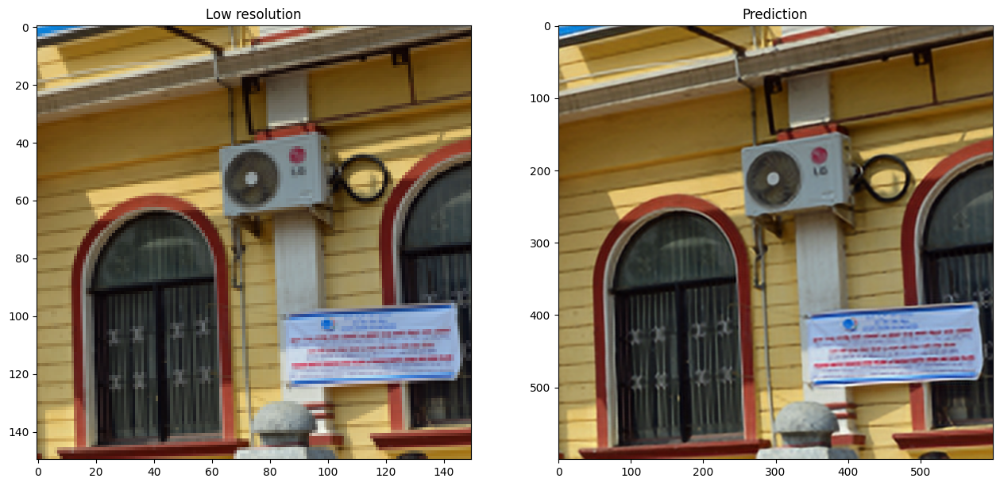

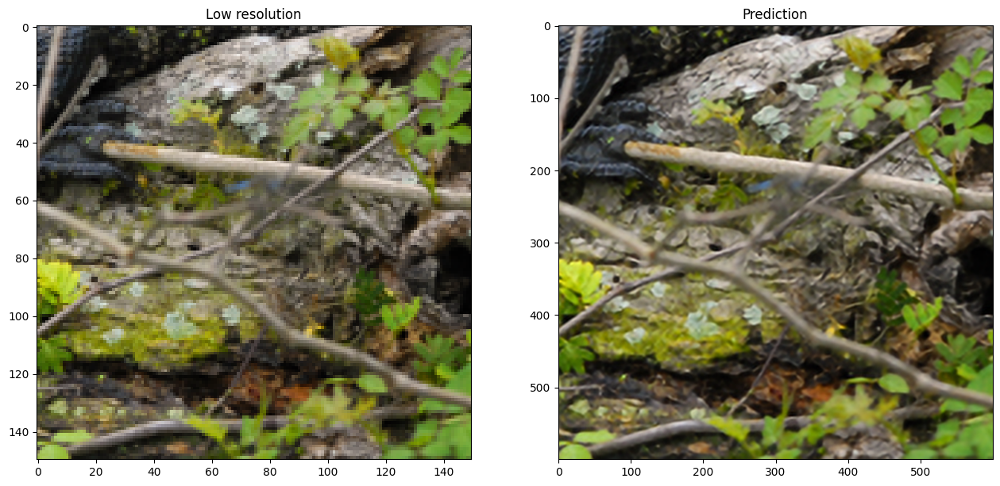

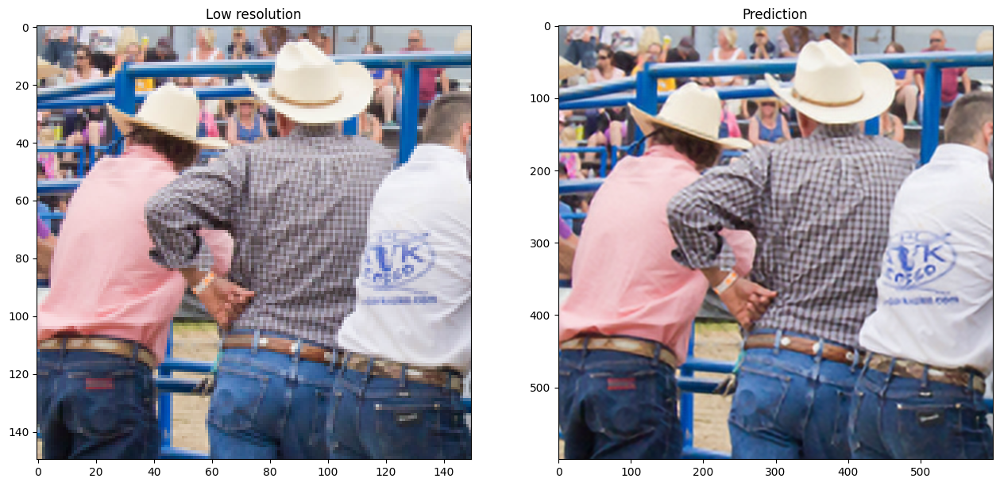

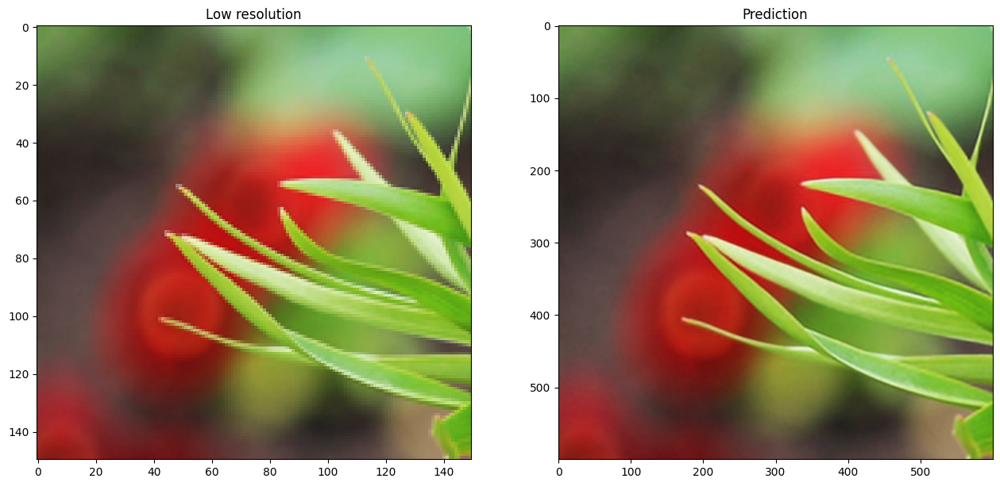

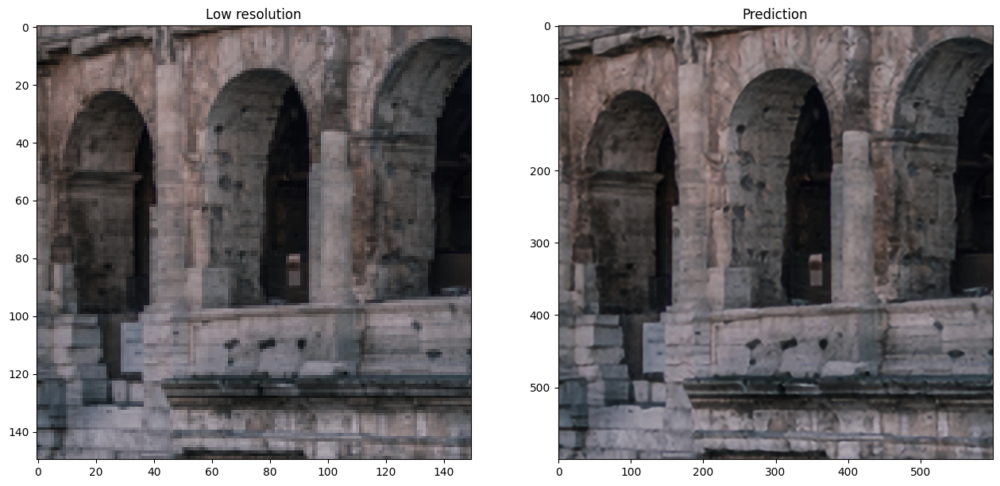

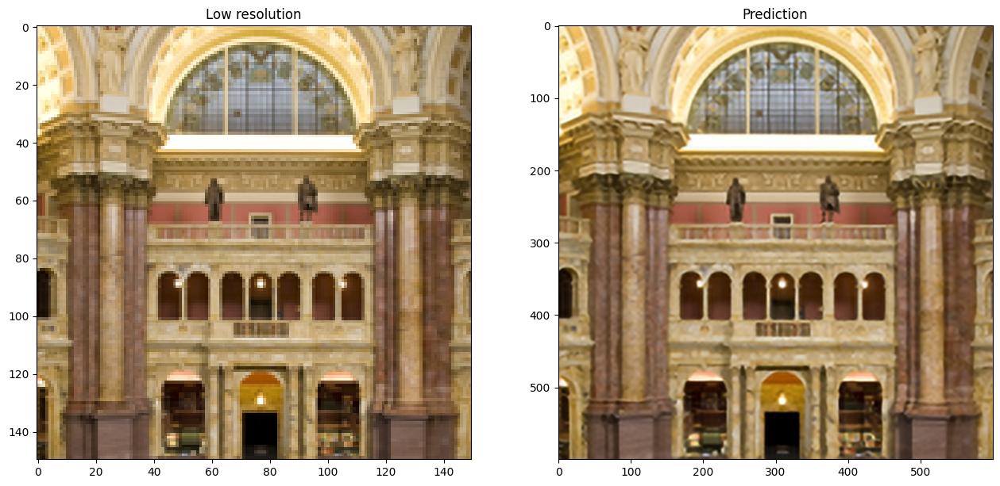

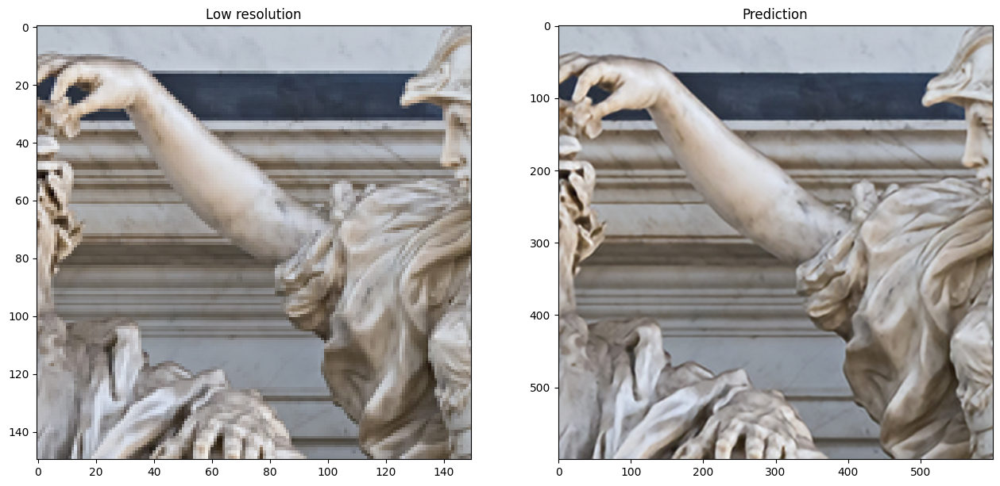

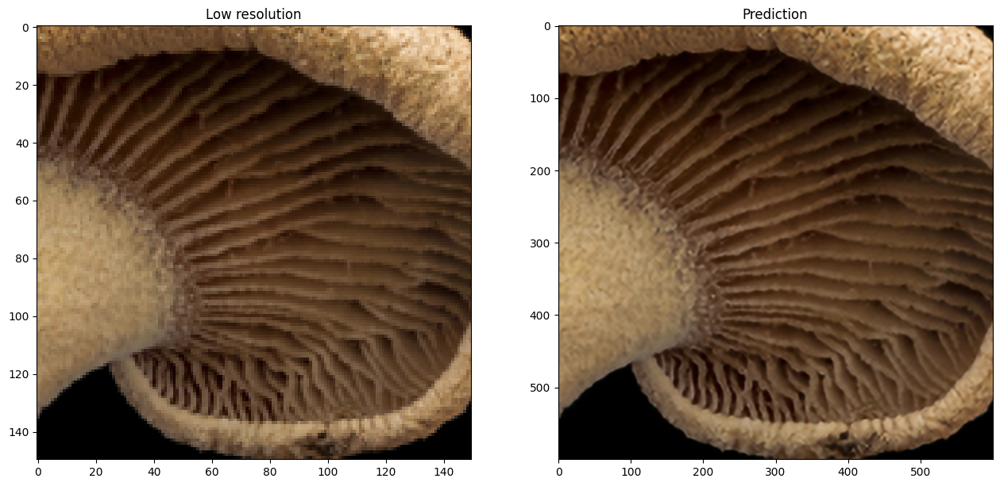

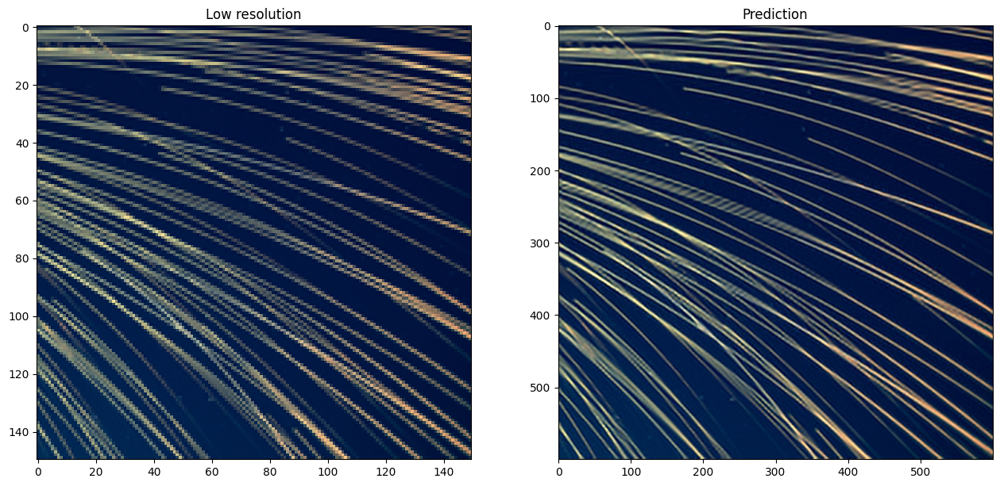

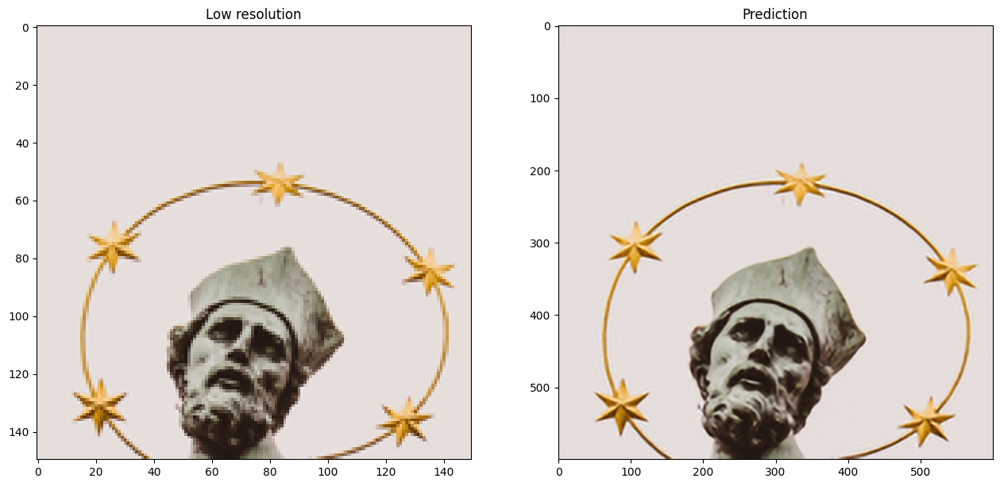

In [ ]:
def plot_results(lowres, preds):

    plt.figure(figsize=(24, 14))
    plt.subplot(132), plt.imshow(lowres), plt.title("Low resolution")
    plt.subplot(133), plt.imshow(preds), plt.title("Prediction")
    plt.show()


for lowres, highres in val.take(10):
    lowres = tf.image.random_crop(lowres, (150, 150, 3))
    preds = model.predict_step(lowres)
    plot_results(lowres, preds)

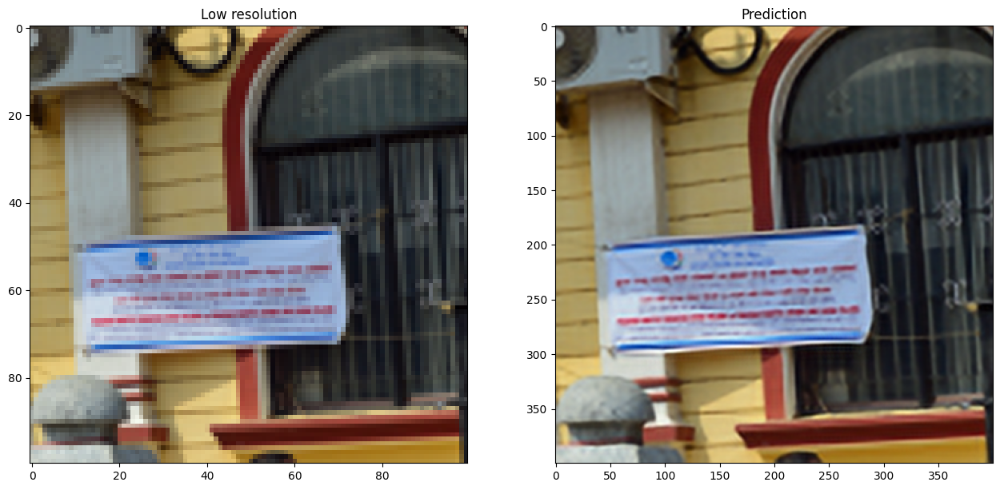

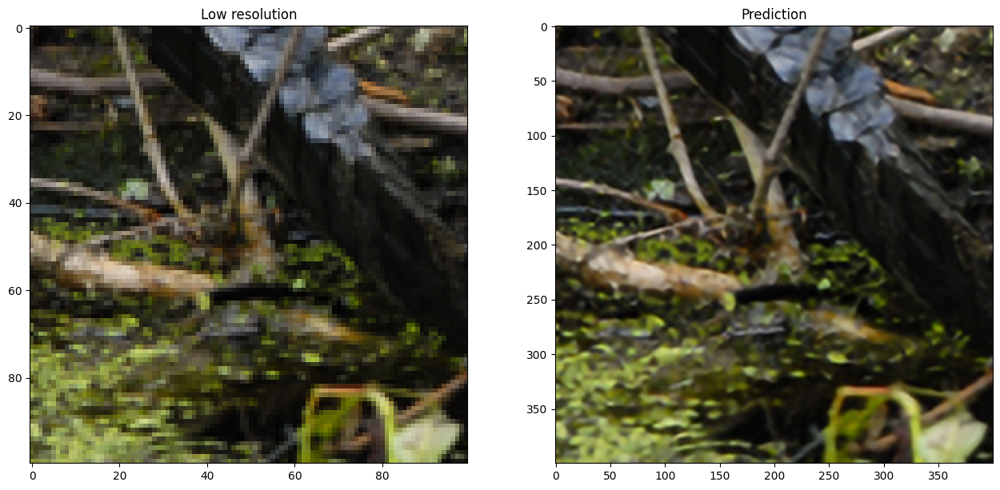

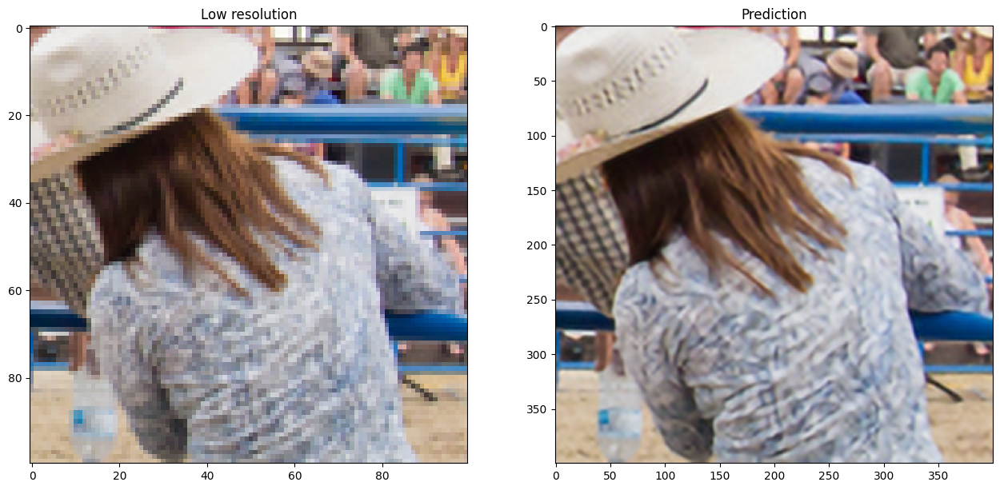

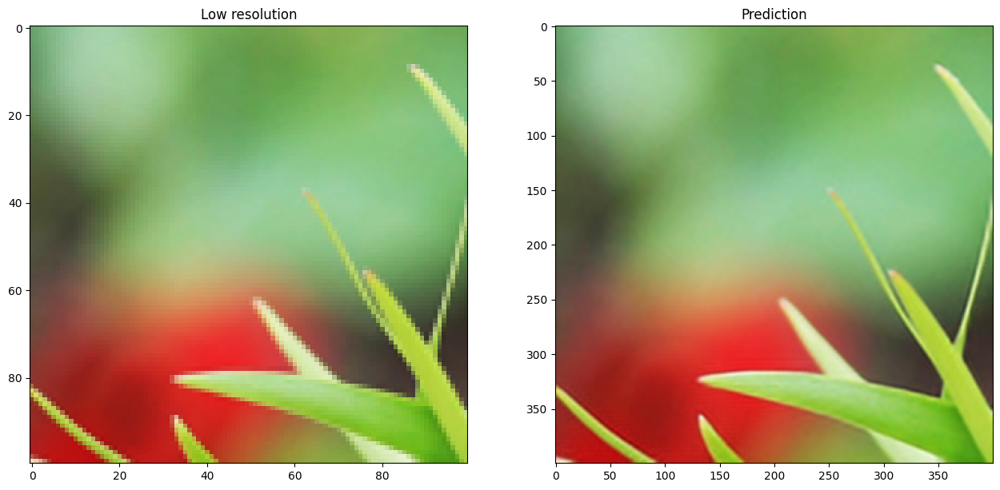

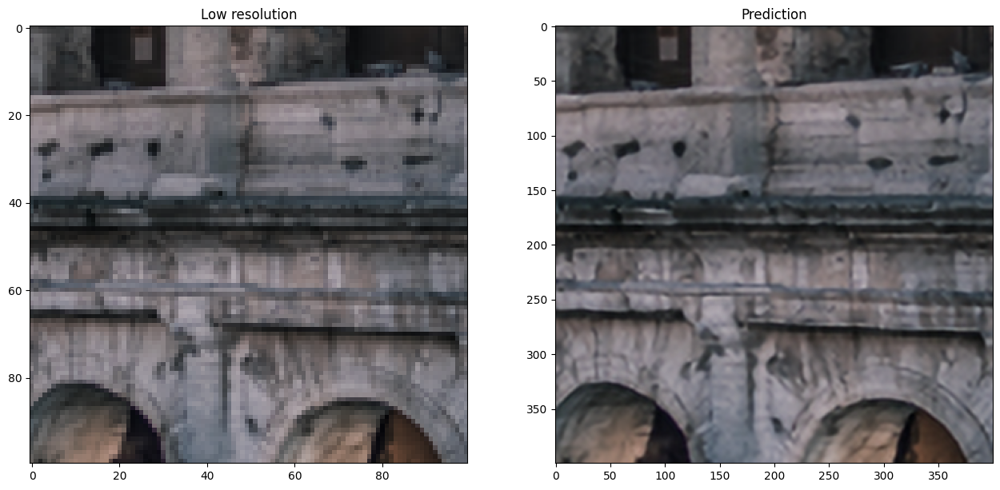

...

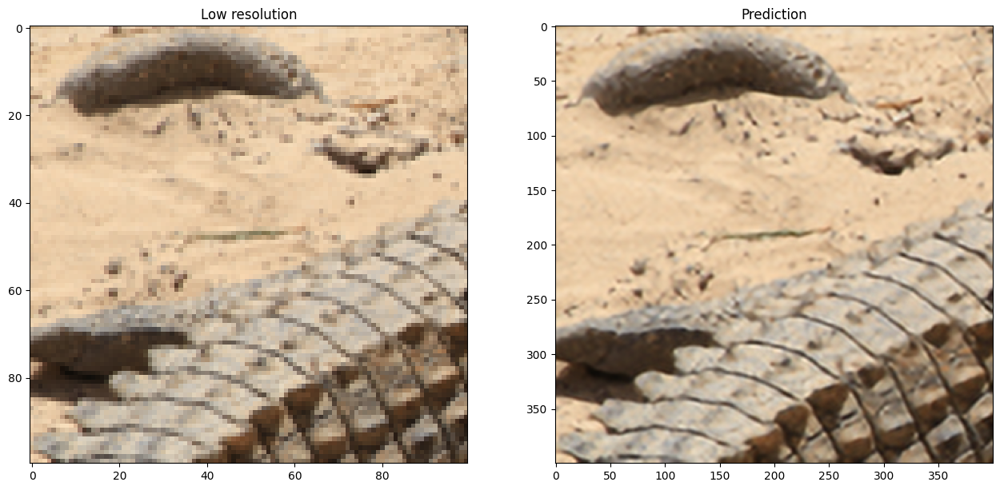

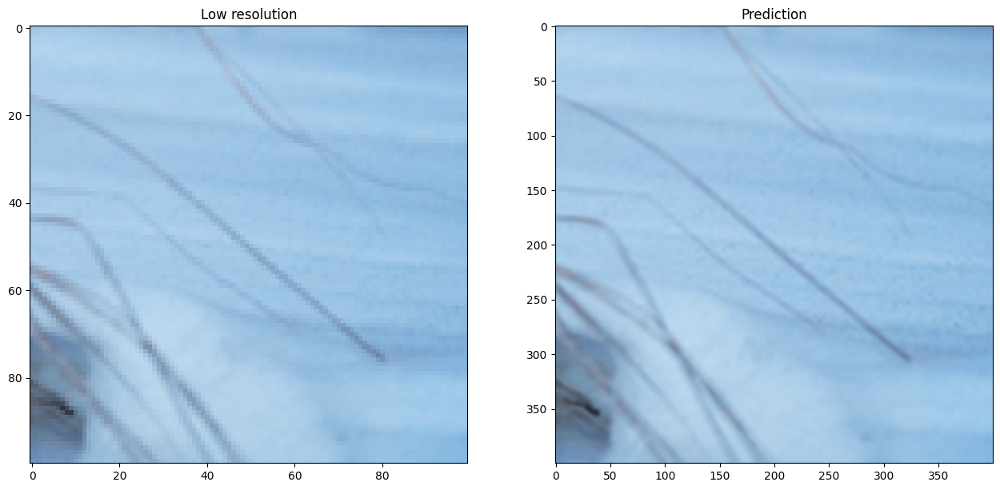

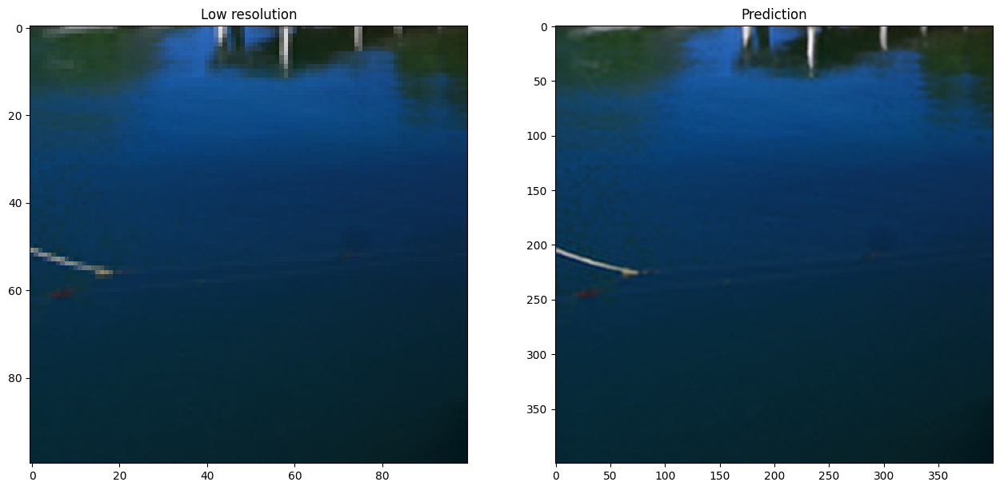

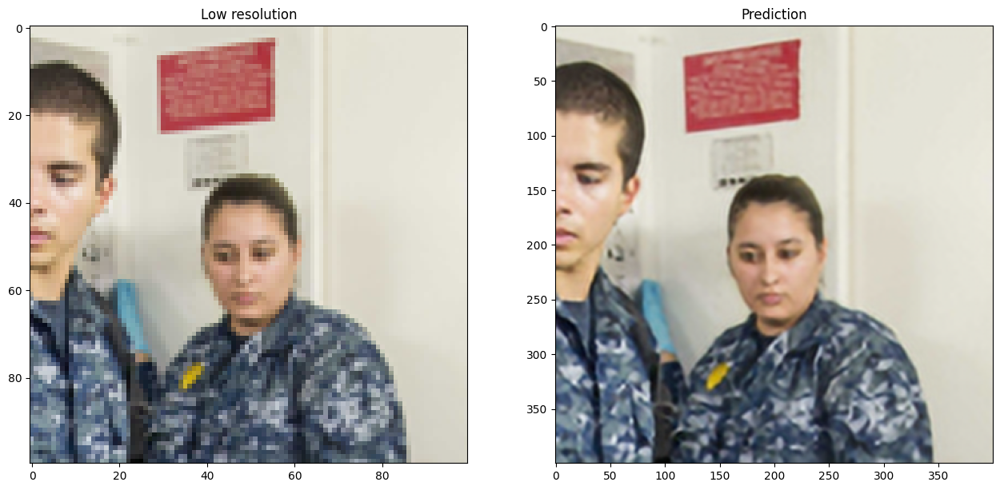

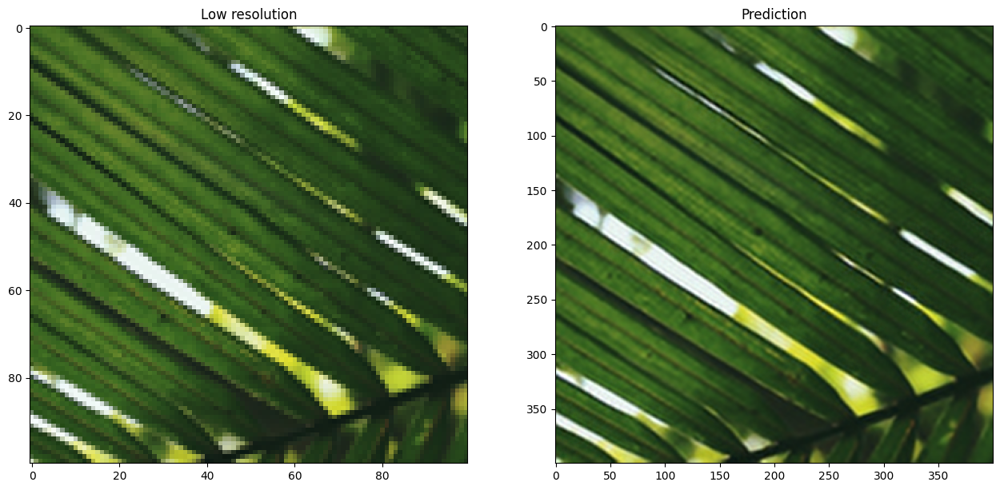

In [ ]:

for lowres, highres in val.take(30):
    lowres = tf.image.random_crop(lowres, (100, 100, 3))
    preds = model.predict_step(lowres)
    plot_results(lowres, preds)
